# Assignment B.5 - Modern face recognition with deep learning

Have you noticed that Facebook has developed an uncanny ability to recognize your friends in your photographs? In the old days, Facebook used to make you to tag your friends in photos by clicking on them and typing in their name. Now as soon as you upload a photo, Facebook tags everyone for you like magic. This technology is called face recognition. Facebook’s algorithms are able to recognize your friends’ faces after they have been tagged only a few times. It’s pretty amazing: these algorithms can recognize faces with 98% accuracy, which is pretty much as good as humans can do!

As a human, your brain is wired to recognize faces automatically and instantly. Computers are not capable of doing this, so you have to teach them how to tackle each step in this process. Specifically, a face recognition system goes through four steps: find faces in the image, analyze their facial features, compare against known faces, and make a prediction of the corresponding persons. Here's described the full pipeline.

<img src="https://perso.esiee.fr/~najmanl/FaceRecognition/figures/summary.gif" style="height:200px;">

### Table of contents

In this assignment, you will tackle several problems related to face recognition:
1. **Face detection**. Look at a picture and find all the faces in it. -5
- **Pose estimation**. Understand where the face is turned and correct its pose. 5
- **Face encoding**. Pick up unique features from a face that can be used to distinguish it from others. 5
- **Face recognition**. Compare the unique features of a face to those of all the people in a database. 5
- **Personal dataset**. Build a custom face recognition dataset. 2

By the end of this notebook, you will have your own face recognition system.

### Required packages

Here are the packages you will need during the assignment.
- [Numpy](http://www.numpy.org)
- [Keras](https://keras.io)
- [OpenCV](https://opencv.org)
- [Dlib](http://dlib.net).

**Note**: In Anaconda Navigator, the package `dlib` can be installed from the **conda-forge** channel. In Google Colab, everything is readily available

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from IPython import display
import cv2
import dlib
import os
import keras
import sklearn
import tensorflow as tf
from tensorflow.keras.preprocessing import image
from tensorflow.keras.optimizers import Adam
from sklearn.model_selection import train_test_split
import pickle
import random
from keras import models, layers

## 1. Face detection

The first step in your pipeline is face detection. Obviously you need to locate the faces in a photograph before you can try to tell them apart. If you’ve used any camera in the last 10 years, you’ve probably seen face detection in action. Face detection is a great feature for cameras. When the camera can automatically pick out faces, it can make sure that all the faces are in focus before it takes the picture. But you’ll use it for a different purpose:  finding the areas of the image you want to pass on to the next step in your pipeline.

<img src="https://perso.esiee.fr/~najmanl/FaceRecognition/figures/detection.jpg" style="height:200px;">

### Assignment

Here's what you are required to do for this part of the assignment.

- You are provided with a small dataset of pictures, where each picture contains exactly one face. Extract the faces and their labels (i.e., the person's names). Store them to a new file with the function `dump` in the package `pickle`.


-  Normalize the cropped faces (i.e., divide the pixel values by 255), and split them in train set (70%) and test set (30%) with the function `train_test_split` in the package `sklearn`.


- Train a small convnet and check its performance on the test set. Remember: don't use the test images for training.


- Try to improve the performance of the baseline convnet by using all the tricks you have learned in the course.

#### Provided functions

Here you will find some useful functions to complete the assignment.

In [ ]:
!wget https://perso.esiee.fr/~najmanl/FaceRecognition/models.zip
!unzip models.zip

In [4]:
hog_detector = dlib.get_frontal_face_detector()
cnn_detector = dlib.cnn_face_detection_model_v1('models/mmod_human_face_detector.dat')

def face_locations(image, model="hog"):

    if model == "hog":
        detector = hog_detector
        cst = 0
    elif model == "cnn":
        detector = cnn_detector
        cst = 10

    matches = detector(image,1)
    rects   = []

    for r in matches:
        if model == "cnn":
            r = r.rect
        x = max(r.left(), 0)
        y = max(r.top(), 0)
        w = min(r.right(), image.shape[1]) - x + cst
        h = min(r.bottom(), image.shape[0]) - y + cst
        rects.append((x,y,w,h))

    return rects

In [5]:
def extract_faces(image, model="hog"):

    gray  = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    rects = face_locations(gray, model)
    faces = []

    for (x,y,w,h) in rects:
        cropped = image[y:y+h, x:x+w, :]
        cropped = cv2.resize(cropped, (128,128))
        faces.append(cropped)

    return faces

In [6]:
def show_grid(faces, figsize=(12,3)):

    n = len(faces)
    cols = 7
    rows = int(np.ceil(n/cols))

    fig, ax = plt.subplots(rows,cols, figsize=figsize)

    for r in range(rows):
        for c in range(cols):
            i = r*cols + c
            if i == n:
                 break
            ax[r,c].imshow(faces[i])
            ax[r,c].axis('off')
            #ax[r,c].set_title('size: ' + str(faces[i].shape[:2]))

In [7]:
def list_images(basePath, validExts=(".jpg", ".jpeg", ".png", ".bmp", ".tif", ".tiff"), contains=None):

    imagePaths = []

    # loop over the directory structure
    for (rootDir, dirNames, filenames) in os.walk(basePath):
        # loop over the filenames in the current directory
        for filename in filenames:
            # if the contains string is not none and the filename does not contain
            # the supplied string, then ignore the file
            if contains is not None and filename.find(contains) == -1:
                continue

            # determine the file extension of the current file
            ext = filename[filename.rfind("."):].lower()

            # check to see if the file is an image and should be processed
            if ext.endswith(validExts):
                # construct the path to the image and yield it
                imagePath = os.path.join(rootDir, filename).replace(" ", "\\ ")
                imagePaths.append(imagePath)

    return imagePaths

#### Hints

The provided function `extract_faces()` applies face detection to a single input image, and returns a list of 128x128 blocks containing the detected faces.

In [8]:
!wget https://perso.esiee.fr/~najmanl/FaceRecognition/figures.zip
!unzip figures.zip 

--2025-04-27 08:47:47--  https://perso.esiee.fr/~najmanl/FaceRecognition/figures.zip
Resolving perso.esiee.fr (perso.esiee.fr)... 147.215.150.8
Connecting to perso.esiee.fr (perso.esiee.fr)|147.215.150.8|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 21536933 (21M) [application/zip]
Saving to: ‘figures.zip’

figures.zip         100%[===================>]  20.54M  13.3MB/s    in 1.5s    

2025-04-27 08:47:49 (13.3 MB/s) - ‘figures.zip’ saved [21536933/21536933]

Archive:  figures.zip
   creating: figures/
  inflating: figures/test.gif        
   creating: __MACOSX/figures/
  inflating: __MACOSX/figures/._test.gif  
  inflating: figures/pose.png        
  inflating: __MACOSX/figures/._pose.png  
  inflating: figures/summary.gif     
  inflating: __MACOSX/figures/._summary.gif  
  inflating: figures/encoding.png    
  inflating: __MACOSX/figures/._encoding.png  
  inflating: figures/triplet.png     
  inflating: __MACOSX/figures/._triplet.png  
  inflating: figu

In [20]:
img = cv2.imread("/kaggle/working/figures/faces.png")
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

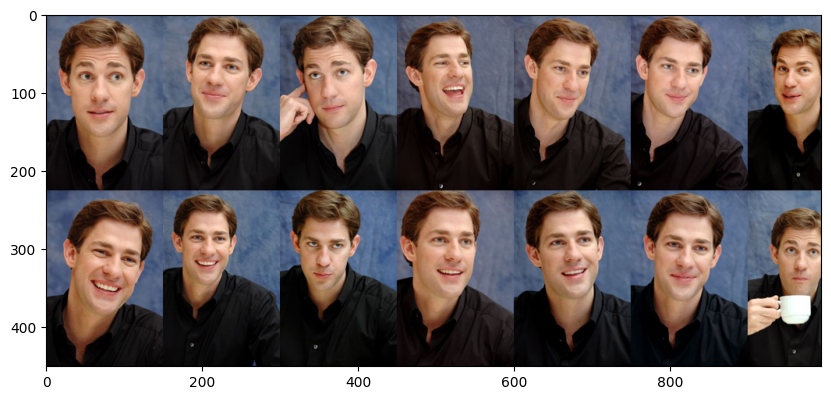

In [21]:
plt.figure(figsize=(10,5))
plt.imshow(img)

In [23]:
faces = extract_faces(img, "cnn")  # Replace 'cnn' with 'hog' for faster but less accurate results

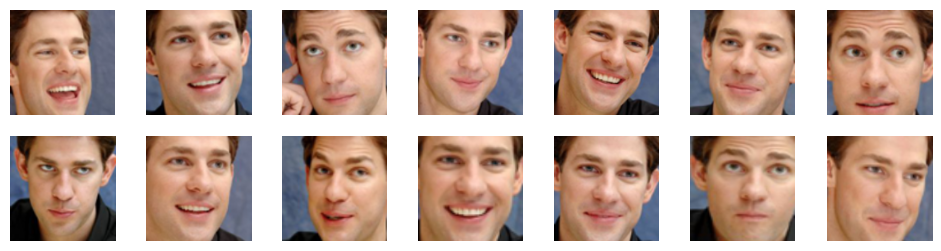

In [24]:
show_grid(faces)

Moreover, the function `list_images()` locates all the jpeg/png/tiff files in a given folder (including its subfolders).

In [ ]:
!wget https://perso.esiee.fr/~najmanl/FaceRecognition/data.zip
!unzip data.zip

--2025-04-27 08:50:41--  https://perso.esiee.fr/~najmanl/FaceRecognition/data.zip
Resolving perso.esiee.fr (perso.esiee.fr)... 147.215.150.8
Connecting to perso.esiee.fr (perso.esiee.fr)|147.215.150.8|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 91829333 (88M) [application/zip]
Saving to: ‘data.zip.1’

data.zip.1           63%[===========>        ]  55.34M  22.7MB/s               

<font color="#2c8ceb" size=6px>**Labels and faces extraction | Dataset creation**</font>


In [14]:
def face_extractions(path, model="cnn"):
   
    faces, labels = [], []

    for imgpath in list_images(path):
        img = cv2.imread(imgpath)
        if img is None:
            print("Skipping unreadable image:", imgpath)
            continue

        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        extracted_faces = extract_faces(img, model)

        if not extracted_faces:
            print("Skipping (no face found):", imgpath)
            continue

        name = imgpath.split("/")[-2]  # nom du dossier parent comme label
        faces.append(extracted_faces[0])
        labels.append(name)

    return faces, labels
 
faces, labels = face_extractions("/kaggle/working/data", "cnn")

with open("face_dataset.pickle", "wb") as file:
    pickle.dump((faces, labels), file)


Skipping (no face found): /kaggle/working/data/ian_malcolm/00000080.jpg
Skipping (no face found): /kaggle/working/data/john_hammond/00000005.png
Skipping (no face found): /kaggle/working/data/john_hammond/00000068.jpg
Skipping (no face found): /kaggle/working/data/john_hammond/00000010.jpg
Skipping (no face found): /kaggle/working/data/john_hammond/00000037.png
Skipping (no face found): /kaggle/working/data/john_hammond/00000013.jpg
Skipping (no face found): /kaggle/working/data/john_hammond/00000065.jpg
Skipping (no face found): /kaggle/working/data/john_hammond/00000090.jpg
Skipping (no face found): /kaggle/working/data/john_hammond/00000036.jpg
Skipping (no face found): /kaggle/working/data/john_hammond/00000031.png


<font color="#2c8ceb" size=6px>**Data Generator | For Validation and Testing purposes**</font>

In [15]:
def oneHotEncoding(labels):
    
    uniqueLabels = list(set(labels))
    labelsToIntegers = {label: idx for idx, label in enumerate(uniqueLabels)}
    integerLabels = [labelsToIntegers[label] for label in labels]
    
    one_hot_labels = tf.keras.utils.to_categorical(integerLabels, num_classes=len(uniqueLabels))
    
    return (integerLabels, one_hot_labels) 

In [16]:
def datasetShuffling(dataset):
    features, labels = dataset
    datasetByPair = list(zip(features, labels))
    random.shuffle(datasetByPair)
    features, labels =  list(zip(*datasetByPair))
    return list(features), list(labels)

In [17]:
# Load dataset
dataset_file = open("face_dataset.pickle", "rb")
dataset = pickle.load(dataset_file)
dataset_file.close()

# shuffling and unpacking of the dataset
faces, labels = datasetShuffling(dataset)

uniqueLabels = list(set(labels))

# Unpack list of tuples
codedLabels = oneHotEncoding(labels)[1] #one-hot encoding

# Convert back to NumPy and Tensor
faces = np.array(faces, dtype=np.float32)

# Normalize images (rescale inside ImageDataGenerator already handles this)
datagen = image.ImageDataGenerator(rescale=1./255, validation_split=0.3)
# Create generators
train_generator = datagen.flow(
    faces, 
    codedLabels, 
    batch_size=32,
    shuffle=True,
    subset="training")

validation_generator = datagen.flow(
    faces, 
    codedLabels,
    batch_size=32,
    shuffle=True,
    subset="validation")

AttributeError: 'numpy.ndarray' object has no attribute 'ImageDataGenerator'

<font color="#2c8ceb" size=6px>**Creation of the model**</font>

In [15]:
num_classes = len(set(labels))

model = models.Sequential([
    layers.Input(shape=(128, 128, 3)),  
    layers.Conv2D(32, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (5, 5), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Flatten(),
    layers.Dropout(0.5),  
    layers.Dense(num_classes, activation='softmax') 
])
    
model.compile(optimizer='adam', 
              loss='categorical_crossentropy', 
              metrics=['accuracy'])


<font color="#2c8ceb" size=6px>**Training**</font>

In [16]:
history = model.fit(
    train_generator,
    epochs=12,
    validation_data=validation_generator
)


Epoch 1/12


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


5/5 ━━━━━━━━━━━━━━━━━━━━ 9s 1s/step - accuracy: 0.1583 - loss: 2.6871 - val_accuracy: 0.1452 - val_loss: 1.7900
Epoch 2/12
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - accuracy: 0.2806 - loss: 1.7640 - val_accuracy: 0.1935 - val_loss: 1.7362
Epoch 3/12
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - accuracy: 0.2952 - loss: 1.6144 - val_accuracy: 0.2419 - val_loss: 1.6420
Epoch 4/12
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - accuracy: 0.3433 - loss: 1.5305 - val_accuracy: 0.2742 - val_loss: 1.6056
Epoch 5/12
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - accuracy: 0.4547 - loss: 1.3167 - val_accuracy: 0.4516 - val_loss: 1.4302
Epoch 6/12
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - accuracy: 0.6162 - loss: 1.0687 - val_accuracy: 0.5968 - val_loss: 1.2351
Epoch 7/12
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - accuracy: 0.7783 - loss: 0.7828 - val_accuracy: 0.6129 - val_loss: 1.0873
Epoch 8/12
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - accuracy: 0.8433 - loss: 0.5653 - val_accuracy: 0.6935 - val_loss: 0.9574
Epoch 9/12
5/

<font color="#2c8ceb" size=6px>**Results**</font>

In [17]:
def plotTrainingResults(history):
    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']
    loss = history.history['loss']
    val_loss = history.history['val_loss']
    
    epochs = range(len(acc))
    
    plt.plot(epochs, acc, 'b', label='Training accuracy')
    plt.plot(epochs, val_acc, 'm', label='Validation accuracy')
    plt.title('Training and validation accuracy')
    plt.legend()
    
    plt.figure()
    
    plt.plot(epochs, loss, 'b', label='Training loss')
    plt.plot(epochs, val_loss, 'm', label='Validation loss')
    plt.title('Training and validation loss')
    plt.legend()
    
    plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 608ms/step


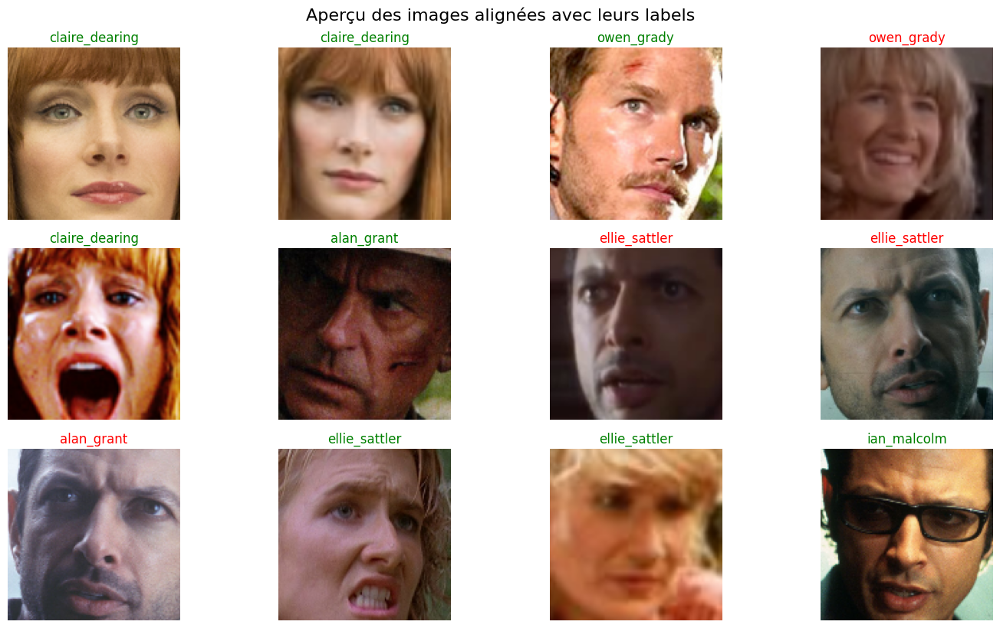

In [18]:
# Nombre d'images à afficher
n_images = 12

test_images, test_labels = next(validation_generator) #premier batch

# Sélection aléatoire d'images
indices = np.random.choice(len(test_images), n_images, replace=False)

# Créer une figure
plt.figure(figsize=(15, 8))

random_faces = np.array([test_images[idx] for idx in indices])

probas = model.predict(random_faces) #probabilités d'appartenance à une classe estimé par le modèle 
predicted_labels = [uniqueLabels[np.argmax(prob)] for prob in probas] #prédictions du modèle 

for i, idx in enumerate(indices):
    
    label = predicted_labels[i]
    img = random_faces[i]
    # Vérification de la bonne prédiction
    if label == uniqueLabels[np.argmax(test_labels[idx])]: 
        color = "green"
    else:
        color = "red"
        
    plt.subplot(3, 4, i + 1)
    plt.imshow(img)  # Si les images sont RGB (shape: HxWx3)
    plt.title(label, color=color)
    plt.axis('off')

plt.tight_layout()
plt.suptitle("Aperçu des images alignées avec leurs labels", fontsize=16, y=1.02)
plt.show()

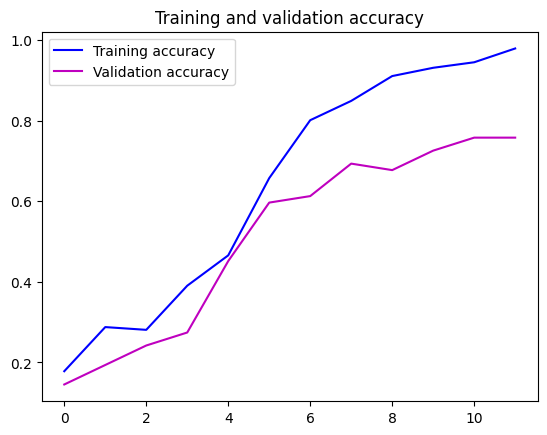

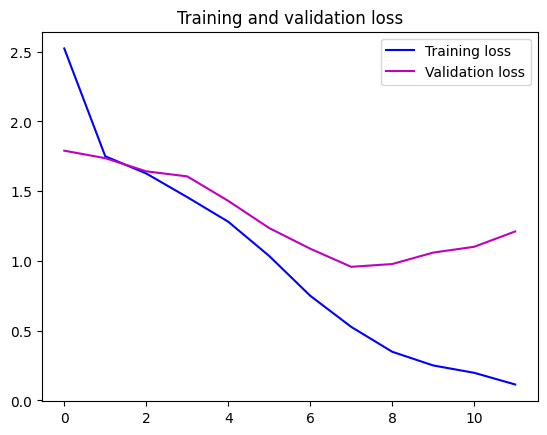

In [19]:
plotTrainingResults(history)

## 2. Pose estimation

You have isolated the faces in our image. But now you have to deal with the problem that faces turned different directions look totally different to a computer. To account for this, you will try to warp each picture so that the eyes and lips are always in the same place in the image. More concretely, you are going to use an algorithm called face landmark estimation. The basic idea is to locate 68 specific points (called landmarks) that exist on every face:  the top of the chin, the outside edge of each eye, the inner edge of each eyebrow, etc. Then, you’ll simply rotate, scale and shear the image so that the eyes and mouth are centered as best as possible. This will make face recognition more accurate.

<img src="https://perso.esiee.fr/~najmanl/FaceRecognition/figures/pose.png" style="height:200px;">

### Assignment

Here's what you are required to do for this part of the assignment.

- Further preprocess the face pictures by correcting their pose. You should now have a dataset of cropped, aligned, and normalized faces.


- Re-train your convnets on the modified dataset.


- Evaluate the performance on the test set, and compare it to the scores obtained with your previously trained convnets.

#### Provided functions

Here you will find some useful functions to complete the assignment.

In [19]:
pose68 = dlib.shape_predictor('/kaggle/working/models/shape_predictor_68_face_landmarks.dat')
pose05 = dlib.shape_predictor('/kaggle/working/models/shape_predictor_5_face_landmarks.dat')

def face_landmarks(face, model="large"):

    if model == "large":
        predictor = pose68
    elif model == "small":
        predictor = pose05

    if not isinstance(face, list):
        rect = dlib.rectangle(0,0,face.shape[1],face.shape[0])
        return predictor(face, rect)
    else:
        rect = dlib.rectangle(0,0,face[0].shape[1],face[0].shape[0])
        return [predictor(f,rect) for f in face]

In [20]:
def shape_to_coords(shape):
    return np.float32([[p.x, p.y] for p in shape.parts()])

In [21]:
TEMPLATE = np.float32([
    (0.0792396913815, 0.339223741112), (0.0829219487236, 0.456955367943),
    (0.0967927109165, 0.575648016728), (0.122141515615, 0.691921601066),
    (0.168687863544, 0.800341263616), (0.239789390707, 0.895732504778),
    (0.325662452515, 0.977068762493), (0.422318282013, 1.04329000149),
    (0.531777802068, 1.06080371126), (0.641296298053, 1.03981924107),
    (0.738105872266, 0.972268833998), (0.824444363295, 0.889624082279),
    (0.894792677532, 0.792494155836), (0.939395486253, 0.681546643421),
    (0.96111933829, 0.562238253072), (0.970579841181, 0.441758925744),
    (0.971193274221, 0.322118743967), (0.163846223133, 0.249151738053),
    (0.21780354657, 0.204255863861), (0.291299351124, 0.192367318323),
    (0.367460241458, 0.203582210627), (0.4392945113, 0.233135599851),
    (0.586445962425, 0.228141644834), (0.660152671635, 0.195923841854),
    (0.737466449096, 0.182360984545), (0.813236546239, 0.192828009114),
    (0.8707571886, 0.235293377042), (0.51534533827, 0.31863546193),
    (0.516221448289, 0.396200446263), (0.517118861835, 0.473797687758),
    (0.51816430343, 0.553157797772), (0.433701156035, 0.604054457668),
    (0.475501237769, 0.62076344024), (0.520712933176, 0.634268222208),
    (0.565874114041, 0.618796581487), (0.607054002672, 0.60157671656),
    (0.252418718401, 0.331052263829), (0.298663015648, 0.302646354002),
    (0.355749724218, 0.303020650651), (0.403718978315, 0.33867711083),
    (0.352507175597, 0.349987615384), (0.296791759886, 0.350478978225),
    (0.631326076346, 0.334136672344), (0.679073381078, 0.29645404267),
    (0.73597236153, 0.294721285802), (0.782865376271, 0.321305281656),
    (0.740312274764, 0.341849376713), (0.68499850091, 0.343734332172),
    (0.353167761422, 0.746189164237), (0.414587777921, 0.719053835073),
    (0.477677654595, 0.706835892494), (0.522732900812, 0.717092275768),
    (0.569832064287, 0.705414478982), (0.635195811927, 0.71565572516),
    (0.69951672331, 0.739419187253), (0.639447159575, 0.805236879972),
    (0.576410514055, 0.835436670169), (0.525398405766, 0.841706377792),
    (0.47641545769, 0.837505914975), (0.41379548902, 0.810045601727),
    (0.380084785646, 0.749979603086), (0.477955996282, 0.74513234612),
    (0.523389793327, 0.748924302636), (0.571057789237, 0.74332894691),
    (0.672409137852, 0.744177032192), (0.572539621444, 0.776609286626),
    (0.5240106503, 0.783370783245), (0.477561227414, 0.778476346951)])

TPL_MIN, TPL_MAX = np.min(TEMPLATE, axis=0), np.max(TEMPLATE, axis=0)
MINMAX_TEMPLATE = (TEMPLATE - TPL_MIN) / (TPL_MAX - TPL_MIN)

INNER_EYES_AND_BOTTOM_LIP = np.array([39, 42, 57])
OUTER_EYES_AND_NOSE = np.array([36, 45, 33])

In [22]:
def align_faces(images, landmarks, idx=INNER_EYES_AND_BOTTOM_LIP):
    faces = []
    for (img, marks) in zip(images, landmarks):
        imgDim = img.shape[0]
        coords = shape_to_coords(marks)
        H = cv2.getAffineTransform(coords[idx], imgDim * MINMAX_TEMPLATE[idx])
        warped = cv2.warpAffine(img, H, (imgDim, imgDim))
        faces.append(warped)
    return faces

#### Hints

The provided function `face_landmarks()` computes the landmarks for a list of cropped faces.

In [453]:
image= cv2.imread('/kaggle/working/figures/faces.png')
image= cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
faces= extract_faces(image,'cnn')

In [454]:
landmarks = face_landmarks(faces)

In [455]:
new_faces = []
for (face,shape) in zip(faces, landmarks):
    canvas = face.copy()
    coords = shape_to_coords(shape)
    for p in coords:
        cv2.circle(canvas, (int(p[0]),int(p[1])), 1, (0, 0, 255), -1)
    new_faces.append(canvas)

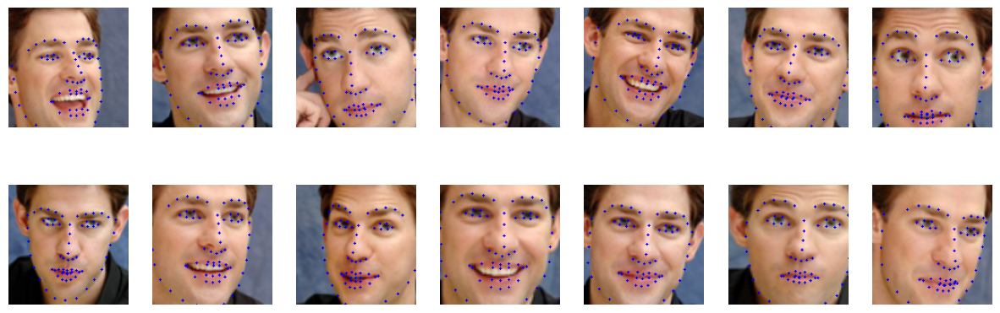

In [457]:
show_grid(new_faces, figsize=(15,5))

In [458]:
aligned = align_faces(faces, landmarks)

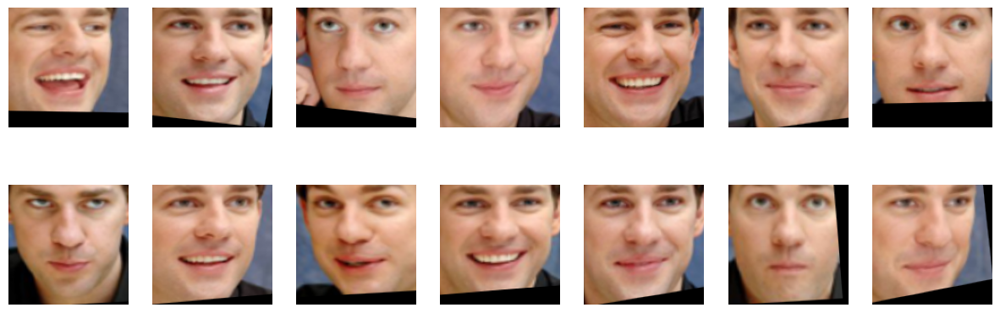

In [459]:
show_grid(aligned, figsize=(15,5))

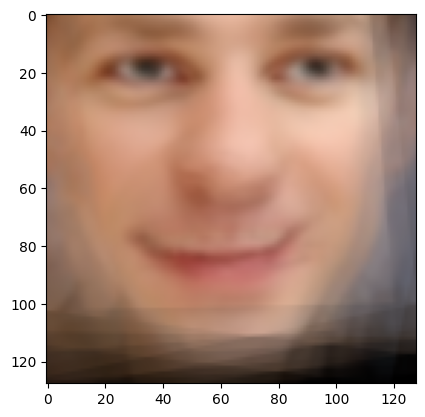

In [460]:
plt.imshow( np.stack(aligned, axis=3).astype(np.float32).mean(axis=3)/255 )

code test 2

In [24]:

# Chargement du dataset pré-extrait
with open('/kaggle/working/face_dataset.pickle', 'rb') as f:
    dataset = pickle.load(f)

faces, raw_labels = datasetShuffling(dataset)

# Correction de la pose (extraction des points de repère + alignement)
landmarks = face_landmarks(faces) 

# Convert back to NumPy and Tensor
aligned_faces = np.array(align_faces(faces, landmarks), dtype=np.float32)
intLabels, codedLabels = oneHotEncoding(raw_labels) #one-hot encoding

# Normalize images (rescale inside ImageDataGenerator already handles this)
datagen = image.ImageDataGenerator(rescale=1./255, validation_split=0.3)

# Create generators
train_generator = datagen.flow(
    aligned_faces, 
    codedLabels, 
    batch_size=32,
    subset="training")

validation_generator = datagen.flow(
    aligned_faces, 
    codedLabels,
    batch_size=32,
    subset="validation")

<font color="#2c8ceb" size=6px>**Creation of the model**</font>

In [32]:
# Architecture du modèle CNN
num_classes = len(set(raw_labels))

face_model = models.Sequential([
    layers.Input(shape=(128, 128, 3)),
    layers.Conv2D(32, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (5, 5), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Flatten(),
    layers.Dropout(0.5),
    layers.Dense(128, activation='relu'),
    layers.Dense(num_classes, activation='softmax')  # détection automatique du nb de classes
])

# Compilation du modèle
face_model.compile(
    optimizer=Adam(learning_rate=0.001),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

<font color="#2c8ceb" size=6px>**Training**</font>

In [33]:

# Entraînement
history = face_model.fit(
    train_generator,
    epochs=12,
    validation_data=validation_generator
)
print("\n")
# Affichage explicite des correspondances one-hot
for idx in range(num_classes):
    one_hot = np.zeros(num_classes)
    one_hot[idx] = 1
    class_name = list(set(raw_labels))[idx]
    print(f"{one_hot} = {idx} --> {class_name}")
    


Epoch 1/12
5/5 ━━━━━━━━━━━━━━━━━━━━ 6s 859ms/step - accuracy: 0.2118 - loss: 2.6016 - val_accuracy: 0.2742 - val_loss: 1.7590
Epoch 2/12
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - accuracy: 0.2795 - loss: 1.7251 - val_accuracy: 0.2903 - val_loss: 1.6359
Epoch 3/12
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - accuracy: 0.4018 - loss: 1.5577 - val_accuracy: 0.3871 - val_loss: 1.4812
Epoch 4/12
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - accuracy: 0.4642 - loss: 1.2791 - val_accuracy: 0.6129 - val_loss: 1.1777
Epoch 5/12
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - accuracy: 0.6762 - loss: 0.8714 - val_accuracy: 0.5484 - val_loss: 1.3254
Epoch 6/12
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - accuracy: 0.7815 - loss: 0.5960 - val_accuracy: 0.6774 - val_loss: 1.1404
Epoch 7/12
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - accuracy: 0.8935 - loss: 0.3506 - val_accuracy: 0.7258 - val_loss: 1.0111
Epoch 8/12
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - accuracy: 0.9721 - loss: 0.1909 - val_accuracy: 0.7581 - val_loss: 0.9172

<font color="#2c8ceb" size=6px>**Results**</font>

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


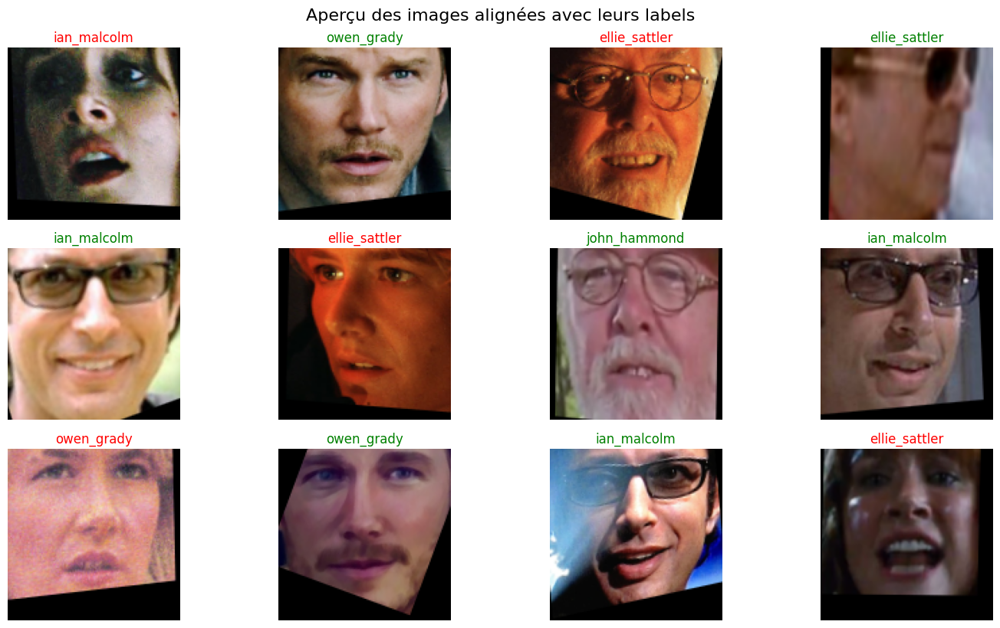

In [34]:
# Nombre d'images à afficher
n_images = 12

test_images, test_labels = next(validation_generator) #premier batch

# Sélection aléatoire d'images
indices = np.random.choice(len(test_images), n_images, replace=False)

# Créer une figure
plt.figure(figsize=(15, 8))

random_faces = np.array([test_images[idx] for idx in indices])

probas = face_model.predict(random_faces) #probabilités d'appartenance à une classe estimé par le modèle 
predicted_labels = [uniqueLabels[np.argmax(prob)] for prob in probas] #prédictions du modèle 

for i, idx in enumerate(indices):
    
    label = predicted_labels[i]
    img = random_faces[i]
    # Vérification de la bonne prédiction
    if label == uniqueLabels[np.argmax(test_labels[idx])]: 
        color = "green"
    else:
        color = "red"
        
    plt.subplot(3, 4, i + 1)
    plt.imshow(img)  # Si les images sont RGB (shape: HxWx3)
    plt.title(label, color=color)
    plt.axis('off')

plt.tight_layout()
plt.suptitle("Aperçu des images alignées avec leurs labels", fontsize=16, y=1.02)
plt.show()

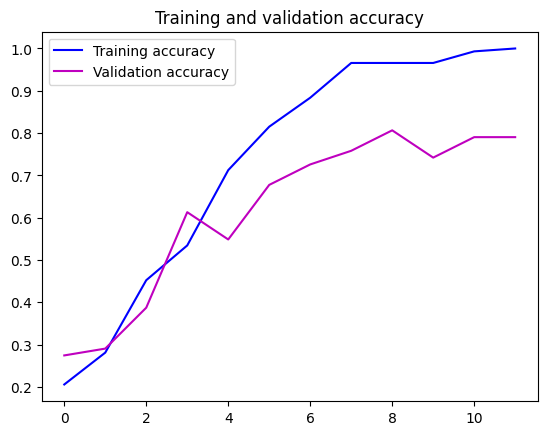

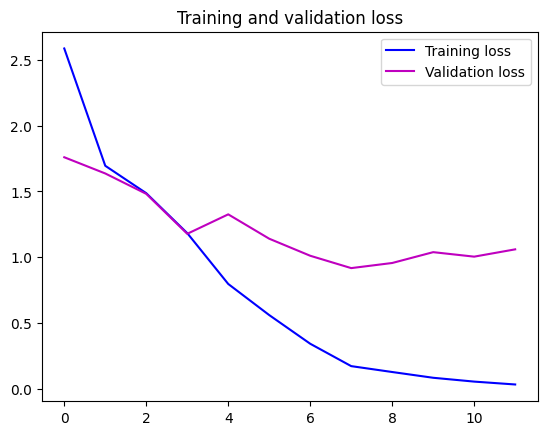

In [36]:
plotTrainingResults(history)

## 3. Face encoding

The simplest approach to face recognition is to directly classify an unknown face with a convnet trained on your database of tagged people. Seems like a pretty good idea, right? There’s actually a huge problem with that approach. A site like Facebook with billions of users and a trillion photos can’t possibly train such a big convnet. That would take way too long. What you need is a way to extract a few basic measurements from each face, which you can then use to quickly compare the unknown face with your database. For example, you might measure the size of each ear, the spacing between the eyes, the length of the nose, etc. However, it turns out that the measurements that seem obvious to us humans (like eye color) don’t really make sense to a computer looking at individual pixels in an image. Researchers have discovered that the most accurate approach is to let the computer figure out the measurements to collect itself. Deep learning does a better job than humans at figuring out which parts of a face are important to measure.

The solution is to train a convnet. But instead of training the network to classify pictures, it is trained to generate 128 measurements for each face. The training process works by looking at 3 face images at a time: the picture of a known person, another picture of the same known person, and a picture of a totally different person. Then, the algorithm looks at the measurements currently generated for each of those three images. It tweaks the neural network slightly to make sure that the measurements generated for the same person are slightly closer, and the measurements for different persons are slightly further apart. After repeating this step millions of times for millions of images of thousands of different people, the convnet learns to generate 128 measurements for each person.

<img src="https://perso.esiee.fr/~najmanl/FaceRecognition/figures/triplet.png" style="height:400px;">

This process of training a convnet to output face encodings requires a lot of data and computer power. Even with an expensive GPU, it takes about 24 hours of continuous training to get good accuracy. But once the network has been trained, it can generate measurements for any face, even ones it has never seen before! So this step only needs to be done once. Fortunately, the people at [OpenFace](https://cmusatyalab.github.io/openface/) already did this and they published several trained networks which you can directly use. So all you need to do is run your face images through their pre-trained network to get the 128 measurements for each face.

<img src="https://perso.esiee.fr/~najmanl/FaceRecognition/figures/encoding.png" style="height:300px;">

### Assignment

Here's what you are required to do for this part of the assignment.

- Preprocess the cropped faces by encoding them. You should now have a dataset of cropped and encoded faces.


- Train a neural network on the modified dataset. Since the encoded faces are just 128-length vectors, **you don't need a convnet**. Use a regular neural network with a series of fully-connected layers.


- Evaluate the performance on the test set, and compare it to the scores obtained with your previously trained convnets.

In [18]:
cnn_encoder = dlib.face_recognition_model_v1('/kaggle/working/models/dlib_face_recognition_resnet_model_v1.dat')

def face_encoder(faces):
    landmarks = face_landmarks(faces)

    if not isinstance(faces, list):
        # Convertir l'image en RGB
        faces_rgb = cv2.cvtColor(faces, cv2.COLOR_BGR2RGB)
        return np.array(cnn_encoder.compute_face_descriptor(faces_rgb, landmarks))
    else:
        faces_rgb = [cv2.cvtColor(f, cv2.COLOR_BGR2RGB) for f in faces]  # Conversion pour chaque image
        return np.array([cnn_encoder.compute_face_descriptor(f, l) for f, l in zip(faces_rgb, landmarks)])


#### Provided functions

#### Hints

The provided function `face_encoder()` computes the encodings for a list of cropped faces. Alignment and normalization are handled internally.

In [485]:
image= cv2.imread('/kaggle/working/figures/faces.png')
image= cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
faces= extract_faces(image,'cnn')

In [486]:

encoded_faces = face_encoder(faces)

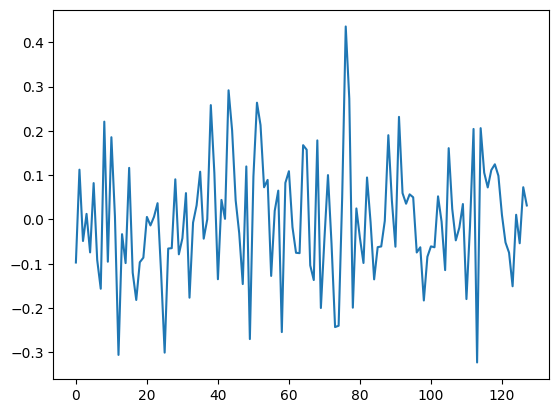

In [487]:
import matplotlib.pyplot as plt


plt.plot(encoded_faces[0])

<font color="#2c8ceb" size=6px>**Encoding of the cropped faces dataset**</font>

[1. 0. 0. 0. 0. 0.] = 0 --> alan_grant
[0. 1. 0. 0. 0. 0.] = 1 --> ellie_sattler
[0. 0. 1. 0. 0. 0.] = 2 --> claire_dearing
[0. 0. 0. 1. 0. 0.] = 3 --> ian_malcolm
[0. 0. 0. 0. 1. 0.] = 4 --> john_hammond
[0. 0. 0. 0. 0. 1.] = 5 --> owen_grady


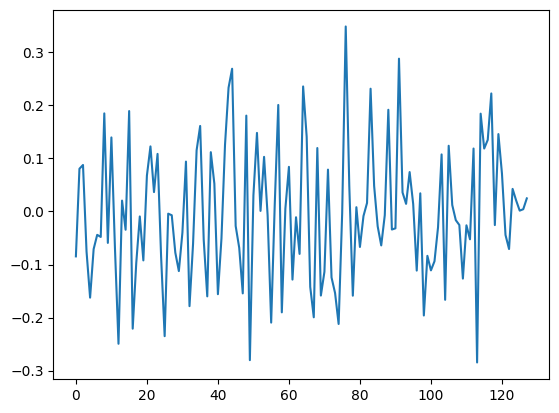

In [608]:
# Chargement du dataset
with open('/kaggle/working/face_dataset.pickle', 'rb') as f:
    dataset = pickle.load(f)

faces, raw_labels = datasetShuffling(dataset)
# Encodage des visages
encoded_faces = face_encoder(faces)

# Affichage d’un vecteur encodé
plt.plot(encoded_faces[0])

codedLabels = oneHotEncoding(np.array(raw_labels))[1]

# Affichage explicite des correspondances one-hot
for idx in range(num_classes):
    one_hot = np.zeros(num_classes)
    one_hot[idx] = 1
    class_name = list(set(raw_labels))[idx]
    print(f"{one_hot} = {idx} --> {class_name}")
    
# Split en jeu d'entraînement et test
train_encoded_faces, validation_encoded_faces, train_labels, validation_labels, test_faces, validation_faces = train_test_split(encoded_faces, codedLabels, faces, test_size=0.3, random_state=42)# Définition du modèle MLP


<font color="#2c8ceb" size=6px>**Creation of the model**</font>

In [609]:
# Définition du modèle MLP

mlp_model = models.Sequential([
    layers.Input(shape=(128,)),  # Le vecteur d'entrée est de taille 128
    layers.Dense(512, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(256, activation='relu'),
    layers.Dense(num_classes, activation='softmax')  # Nombre de classes à prédire
])

# Compilation du modèle
mlp_model.compile(
    optimizer=Adam(learning_rate=0.001),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

<font color="#2c8ceb" size=6px>**Training**</font>

In [610]:
# Entraînement du modèle MLP
history_mlp = mlp_model.fit(
    train_encoded_faces, 
    train_labels, 
    epochs=12, 
    validation_data=(validation_encoded_faces, validation_labels)
)

# Évaluation sur le jeu de test
mlp_test_loss, mlp_test_acc = mlp_model.evaluate(validation_encoded_faces, validation_labels)
print(f"MLP Test accuracy: {mlp_test_acc * 100:.2f}%")

Epoch 1/12
5/5 ━━━━━━━━━━━━━━━━━━━━ 3s 426ms/step - accuracy: 0.2083 - loss: 1.7780 - val_accuracy: 0.2222 - val_loss: 1.6779
Epoch 2/12
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.2456 - loss: 1.6246 - val_accuracy: 0.2222 - val_loss: 1.5826
Epoch 3/12
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.2970 - loss: 1.5291 - val_accuracy: 0.5238 - val_loss: 1.3910
Epoch 4/12
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.5721 - loss: 1.2775 - val_accuracy: 0.6349 - val_loss: 1.1688
Epoch 5/12
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.7292 - loss: 1.0833 - val_accuracy: 0.8730 - val_loss: 0.9724
Epoch 6/12
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.8951 - loss: 0.8828 - val_accuracy: 0.9524 - val_loss: 0.7569
Epoch 7/12
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.9541 - loss: 0.7272 - val_accuracy: 0.9683 - val_loss: 0.5560
Epoch 8/12
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.9429 - loss: 0.5165 - val_accuracy: 0.9683 - val_loss: 0.4128
Epoch 

<font color="#2c8ceb" size=6px>**Results**</font>

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


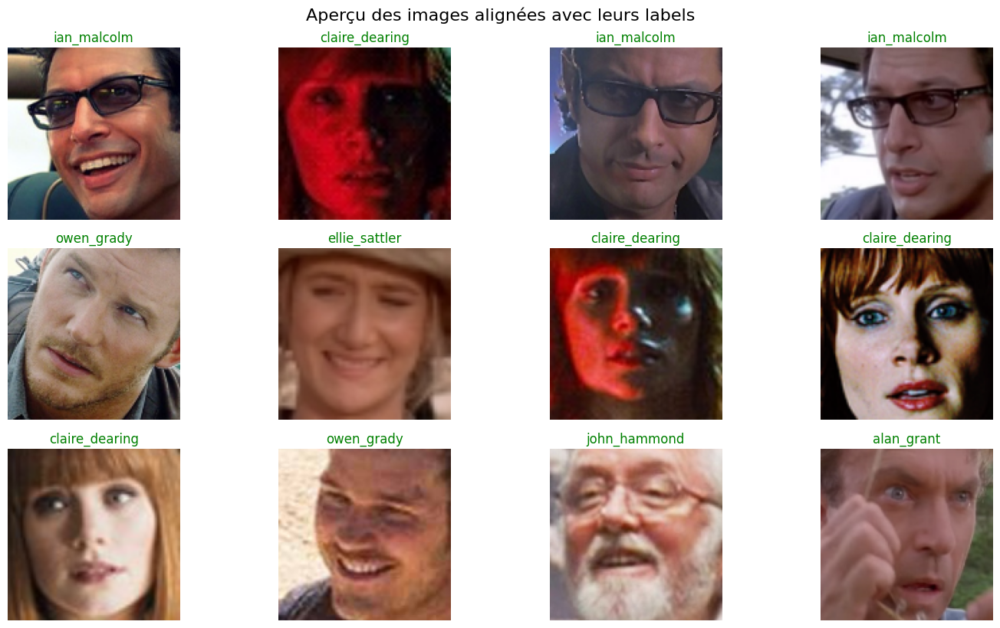

In [538]:
# Nombre d'images à afficher
n_images = 12
# Sélection aléatoire d'images

indices = np.random.choice(len(validation_faces), n_images, replace="False")

# Créer une figure
plt.figure(figsize=(15, 8))

random_faces_measures = np.array([validation_encoded_faces[idx] for idx in indices])
random_faces = np.array([validation_faces[idx] for idx in indices])

predictions = mlp_model.predict(random_faces_measures)

predicted_labels = [uniqueLabels[np.argmax(pred)] for pred in predictions]

for i, idx in enumerate(indices):
    
    label = predicted_labels[i]
    img = random_faces[i]

    if predicted_labels[i] == uniqueLabels[np.argmax(validation_labels[idx])]:
        color = "green"
    else:
        color = "red"
        
    plt.subplot(3, 4, i + 1)
    plt.imshow(img)  # Si les images sont RGB (shape: HxWx3)
    plt.title(label, color=color)
    plt.axis('off')

plt.tight_layout()
plt.suptitle("Aperçu des images alignées avec leurs labels", fontsize=16, y=1.02)
plt.show()


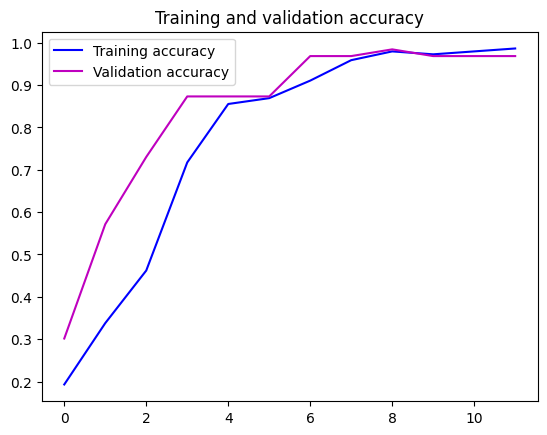

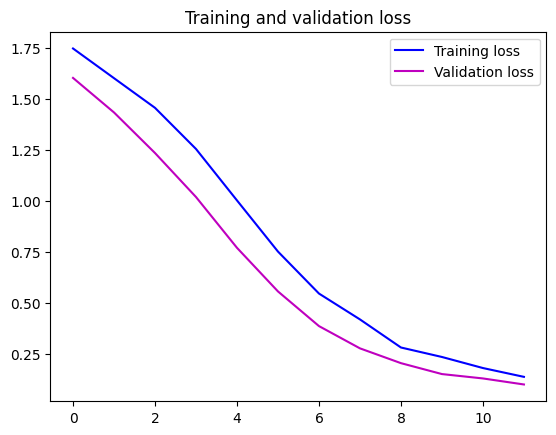

In [540]:
plotTrainingResults(history_mlp)

## 4. Face recognition

This last step is actually the easiest one in the whole process. All you have to do is find the person in your database of known people who has the closest measurements to some test image. You can do that by using any machine learning classification algorithm, such as neaural network (as you did in the previous section), logistic regression, SVM, nearest neighbours, etc. All you need to do is training a classifier that can take in the measurements from a new test image, and tells which known person is the closest match. Running this classifier must only take milliseconds, so that you can apply it to video sequences.

<img src="https://perso.esiee.fr/~najmanl/FaceRecognition/figures/test.gif" style="height:300px;">

### Assignment

Here's what you are required to do for this part of the assignment.

-  Train several classifiers (logistic regression, SVM, kNN, neural network) on the dataset of encoded faces (you can use the package `scikit-learn`).

- Evaluate their performance on the test set, in terms of accuracy and speed.

- Finally, run your best classifier on the test images and video available in the `test` folder.

#### Provided functions

In [19]:
def process_frame(image, mode="fast"):

    # face detection
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    if mode == "fast":
        matches = hog_detector(gray,1)
    else:
        matches = cnn_detector(gray,1)
        matches = [m.rect for m in matches]

    for rect in matches:

        # face landmarks
        landmarks = pose68(gray, rect)

        # face encoding
        encoding = cnn_encoder.compute_face_descriptor(image, landmarks)

        # face classification
        label = "label"

        # draw box
        cv2.rectangle(image, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
        y = rect.top() - 15 if rect.top() - 15 > 15 else rect.bottom() + 25
        cv2.putText(image, label, (rect.left(), y), cv2.FONT_HERSHEY_SIMPLEX, 0.75, (0, 255, 0), 2)

    return image

**Note:** cv2.VideoCapture does not work in Google Colab. You can use https://colab.research.google.com/notebooks/snippets/advanced_outputs.ipynb#scrollTo=2viqYx97hPMi to capture video 'on the fly' with Google Colab. The following function has to be modified accordingly

In [542]:
def process_movie(video_name, outvideo_name='/kaggle/working/test/lunch_scene.mp4', mode="fast"):

    video  = cv2.VideoCapture(video_name)
    if (video.isOpened()== False): 
        print("Error opening video stream or file")
        return
    
    frame_width = int(video.get(3))
    frame_height = int(video.get(4))
    out_mp4 = cv2.VideoWriter(outvideo_name,cv2.VideoWriter_fourcc(*'XVID'), 10, (frame_width//2,frame_height//2))

    i=0
    while video.isOpened():

        # Grab a single frame of video
        ret, frame = video.read()
        if ret == True:
            # Resize frame of video for faster processing
            frame = cv2.resize(frame, (0, 0), fx=0.5, fy=0.5)
            # Process frame
            image = process_frame(frame, mode)
            # Write the processed frame to output video
            out_mp4.write(image)
        else:
            break
        i += 1
        if i==1000:
            break
    # Release video
    video.release()
    out_mp4.release()
    print("Video released")





In [543]:
from IPython.display import HTML
from base64 import b64encode

def play(filename):
    html = ''
    video = open(filename,'rb').read()
    src = 'data:video/mp4;base64,' + b64encode(video).decode()
    html += '<video width=1000 controls autoplay loop><source src="%s" type="video/mp4"></video>' % src 
    return HTML(html)

play('/kaggle/working/test/lunch_scene.mp4')

#### Hints

The provided function `process_frame()` detects and encodes all the faces in the input image.

In [20]:
!wget https://perso.esiee.fr/~najmanl/FaceRecognition/test.zip
!unzip test.zip

--2025-04-26 08:15:25--  https://perso.esiee.fr/~najmanl/FaceRecognition/test.zip
Resolving perso.esiee.fr (perso.esiee.fr)... 147.215.150.8
Connecting to perso.esiee.fr (perso.esiee.fr)|147.215.150.8|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 12530126 (12M) [application/zip]
Saving to: ‘test.zip’

test.zip            100%[===================>]  11.95M  40.6MB/s    in 0.3s    

2025-04-26 08:15:25 (40.6 MB/s) - ‘test.zip’ saved [12530126/12530126]

Archive:  test.zip
   creating: test/
  inflating: test/lunch_scene.mp4    
   creating: __MACOSX/test/
  inflating: __MACOSX/test/._lunch_scene.mp4  
  inflating: test/example_03.png     
  inflating: __MACOSX/test/._example_03.png  
  inflating: test/example_02.png     
  inflating: __MACOSX/test/._example_02.png  
  inflating: test/example_01.png     
  inflating: __MACOSX/test/._example_01.png  
  inflating: __MACOSX/._test         


In [544]:
image = cv2.imread("/kaggle/working/test/example_03.png")

In [545]:
processed = process_frame(image.copy())
processed = cv2.cvtColor(processed, cv2.COLOR_BGR2RGB)

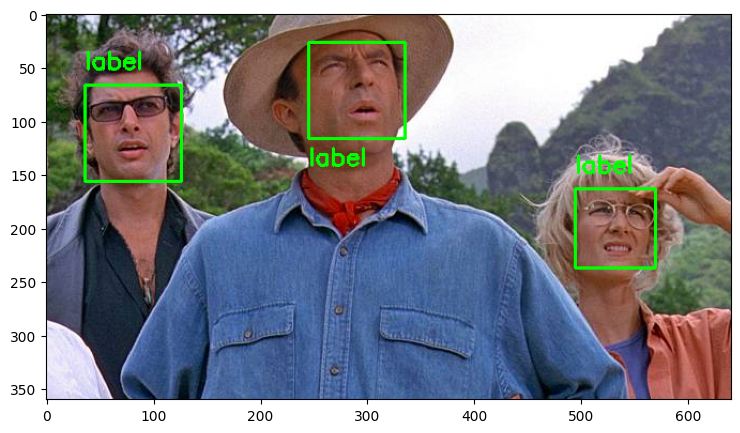

In [546]:
plt.figure(figsize=(15,5))
plt.imshow(processed)

The provided function `process_frame()` detects and encodes the faces in the input video.

In [ ]:
process_movie("/kaggle/input/test-ex4/lunch_scene.mp4")

The special input `0` can be used to access the webcam.

In [ ]:
process_movie(0)

<font color="#2c8ceb" size=6px>**Training several classifiers**</font>

In [29]:
# Classificateurs
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import (
    RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier
)
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB, BernoulliNB
from sklearn.neural_network import MLPClassifier

# Charger les visages et les labels
with open("/kaggle/working/face_dataset.pickle", "rb") as f:
    dataset = pickle.load(f)
    
faces, raw_labels = datasetShuffling(dataset)

# Encoder les visages
encoded_faces = face_encoder(faces)

# Encoder les étiquettes

intLabels = oneHotEncoding(raw_labels)[0] #avoir un vecteur de labels
# Split en jeu d'entraînement/test
train_encoded_faces, validation_encoded_faces, train_labels, validation_labels = train_test_split(
    encoded_faces, intLabels, test_size=0.3, random_state=42
)
# les diff
classifiers = [(LogisticRegression, "LogisticRegression"),
               (RandomForestClassifier, "RandomForestClassifier"),
               (KNeighborsClassifier, "KNeighborsClassifier"),
               (SVC, "SVC"),
               (DecisionTreeClassifier, "DecisionTreeClassifier"),
               (GaussianNB, "GaussianNB"),
               (BernoulliNB, "BernoulliNB"),
               (GradientBoostingClassifier, "GradientBoostingClassifier"),
               (AdaBoostClassifier, "AdaBoostClassifier"),
               (MLPClassifier, "MLPClassifier")]

model_configs = {
    "LogisticRegression": {
        "solver": "liblinear",  # good for small datasets
        "max_iter": 1000
    },
    "RandomForestClassifier": {
        "n_estimators": 100,
        "random_state": 42
    },
    "KNeighborsClassifier": {
        "n_neighbors": 5
    },
    "SVC": {
        "kernel": "rbf",
        "C": 1.0,
        "probability": True  # enable predict_proba if needed
    },
    "DecisionTreeClassifier": {
        "max_depth": 5,
        "random_state": 42
    },
    "GaussianNB": {},  # No parameters needed
    "BernoulliNB": {
        "alpha": 1.0
    },
    "GradientBoostingClassifier": {
        "n_estimators": 100,
        "learning_rate": 0.1,
        "random_state": 42
    },
    "AdaBoostClassifier": {
        "n_estimators": 50,
        "learning_rate": 1.0,
        "random_state": 42
    },
    "MLPClassifier": {
        "hidden_layer_sizes": (100,),
        "max_iter": 300,
        "random_state": 42
    }
}
accuracies = []

for model_class, name in classifiers:
    print(f" Classifier : {name}")
    args = model_configs.get(name, {})
    model = model_class(**args)

    model.fit(train_encoded_faces, train_labels)
    y_pred = model.predict(validation_encoded_faces)
    acc = accuracy_score(validation_labels, y_pred)
    accuracies.append(acc)

    print(f"Accuracy : {acc * 100:.2f}%\n")

# Meilleur modèle
best_index = np.argmax(accuracies)
best_name = classifiers[best_index][1]
print(f" Le meilleur classificateur est : {best_name} avec {accuracies[best_index] * 100:.2f}% de précision")


 Classifier : LogisticRegression
Accuracy : 96.83%

 Classifier : RandomForestClassifier
Accuracy : 100.00%

 Classifier : KNeighborsClassifier
Accuracy : 98.41%

 Classifier : SVC
Accuracy : 98.41%

 Classifier : DecisionTreeClassifier
Accuracy : 69.84%

 Classifier : GaussianNB
Accuracy : 100.00%

 Classifier : BernoulliNB
Accuracy : 95.24%

 Classifier : GradientBoostingClassifier
Accuracy : 80.95%

 Classifier : AdaBoostClassifier
Accuracy : 39.68%

 Classifier : MLPClassifier
Accuracy : 100.00%

 Le meilleur classificateur est : RandomForestClassifier avec 100.00% de précision


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  warnings.warn(


<font color="#2c8ceb" size=6px>**Training with the best classifier**</font>

In [31]:
import joblib

# En supposant que tu as la liste `classifiers` et `accuracies`
best_index = np.argmax(accuracies)
best_model_class, best_name = classifiers[best_index]
best_model = best_model_class(**model_configs[best_name])

# Entraîne le meilleur modèle sur tout le dataset (optionnel mais recommandé)
best_model.fit(encoded_faces, intLabels)

# Sauvegarde du modèle et du label encoder
joblib.dump(best_model, f"/kaggle/working/best_model_{best_name}.pkl")

print(f" Modèle et encoder sauvegardés sous : best_model_{best_name}.pkl")


 Modèle et encoder sauvegardés sous : best_model_RandomForestClassifier.pkl


<font color="#2c8ceb" size=6px>**Image test**</font>

In [165]:
# Charger le classifieur et le label encoder une fois pour toutes
clf = joblib.load("/kaggle/working/best_model_"+best_name+".pkl")  # Remplace par le nom correct
label_encoder = joblib.load("/kaggle/working/label_encoder.pkl")

def process_frame(image, mode="fast"):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    if mode == "fast":
        matches = hog_detector(gray, 1)
    else:
        matches = cnn_detector(gray, 1)
        matches = [m.rect for m in matches]

    for rect in matches:
        landmarks = pose68(gray, rect)
        encoding = cnn_encoder.compute_face_descriptor(image, landmarks)
        encoding = np.array(encoding).reshape(1, -1)

        pred = clf.predict(encoding)[0]
        label = label_encoder.inverse_transform([pred])[0]

        # Dessiner la boîte et le label
        cv2.rectangle(image, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
        y = rect.top() - 15 if rect.top() - 15 > 15 else rect.bottom() + 25
        cv2.putText(image, label, (rect.left(), y), cv2.FONT_HERSHEY_SIMPLEX, 0.75, (0, 255, 0), 2)

    return image

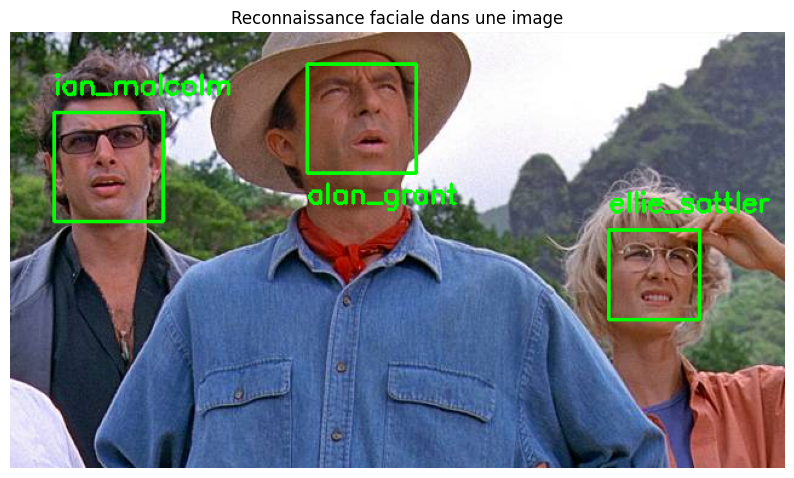

In [166]:
# Lire et traiter une image de test
image = cv2.imread("/kaggle/working/test/example_03.png")
processed = process_frame(image.copy(), mode="fast")
processed = cv2.cvtColor(processed, cv2.COLOR_BGR2RGB)

# Affichage
plt.figure(figsize=(10,6))
plt.imshow(processed)
plt.axis('off')
plt.title("Reconnaissance faciale dans une image")
plt.show()


In [ ]:
process_movie("/kaggle/input/test-ex4/lunch_scene.mp4", outvideo_name='/kaggle/working/videoResult1.mp4')

In [ ]:
from IPython.display import HTML
from base64 import b64encode

def play(filename):
    html = ''
    video = open(filename,'rb').read()
    src = 'data:video/mp4;base64,' + b64encode(video).decode()
    html += '<video width=1000 controls autoplay loop><source src="%s" type="video/mp4"></video>' % src 
    return HTML(html)

play('/kaggle/working/videoResult1.mp4')


## 5. Build a custom dataset

So far, you have used a pre-curated dataset, where somebody did the hard work of gathering and labeling the images for you. Now, you will tackle the problem of recognizing faces of yourselves, friends, family members, colleagues, etc. To accomplish this, you need to gather examples of faces you want to recognize. You can enroll facial pictures via a webcam attached to your computer.

### Assignment
Here's what you are required to do for this part of the assignment.

- Use your webcam to enroll face pictures of yourself, your friends, etc. To do so, you need to open the webcam, detect faces in the video stream, and save the captured face images to disk.


- Build a dataset of reasonable size: a group of 10-15 people with 50-100 face pictures each, taken in different conditions of light, angle, emotion, etc.


- Apply the previously developed pipeline to build your own personalized face recognition system.

In [1]:
!wget http://perso.esiee.fr/~amaray/DATASET.zip
!unzip DATASET.zip

--2025-04-27 08:39:19--  http://perso.esiee.fr/~amaray/DATASET.zip
Resolving perso.esiee.fr (perso.esiee.fr)... 147.215.150.8
Connecting to perso.esiee.fr (perso.esiee.fr)|147.215.150.8|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://perso.esiee.fr/~amaray/DATASET.zip [following]
--2025-04-27 08:39:20--  https://perso.esiee.fr/~amaray/DATASET.zip
Connecting to perso.esiee.fr (perso.esiee.fr)|147.215.150.8|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 17266234 (16M) [application/zip]
Saving to: ‘DATASET.zip’

DATASET.zip         100%[===================>]  16.47M  8.25MB/s    in 2.0s    

2025-04-27 08:39:22 (8.25 MB/s) - ‘DATASET.zip’ saved [17266234/17266234]

Archive:  DATASET.zip
  inflating: DATASET/aymen/aymen00.jpg  
  inflating: DATASET/aymen/aymen16.jpg  
  inflating: DATASET/aymen/aymen20.jpg  
  inflating: DATASET/aymen/aymen13.jpg  
  inflating: DATASET/aymen/aymen23.jpg  
  inflating: DATASET/aymen/aymen21.jp

In [15]:
imagePaths = list_images("/kaggle/working/DATASET")
imagePaths

['/kaggle/working/DATASET/aissato/aissato58.jpg',
 '/kaggle/working/DATASET/aissato/aissato06.jpg',
 '/kaggle/working/DATASET/aissato/aissato11.jpg',
 '/kaggle/working/DATASET/aissato/aissato59.jpg',
 '/kaggle/working/DATASET/aissato/aissato57.jpg',
 '/kaggle/working/DATASET/aissato/aissato56.jpg',
 '/kaggle/working/DATASET/aissato/aissato38.jpg',
 '/kaggle/working/DATASET/aissato/aissato18.jpg',
 '/kaggle/working/DATASET/aissato/aissato46.jpg',
 '/kaggle/working/DATASET/aissato/aissato19.jpg',
 '/kaggle/working/DATASET/aissato/aissato22.jpg',
 '/kaggle/working/DATASET/aissato/aissato04.jpg',
 '/kaggle/working/DATASET/aissato/aissato54.jpg',
 '/kaggle/working/DATASET/aissato/aissato63.jpg',
 '/kaggle/working/DATASET/aissato/aissato45.jpg',
 '/kaggle/working/DATASET/aissato/aissato53.jpg',
 '/kaggle/working/DATASET/aissato/aissato49.jpg',
 '/kaggle/working/DATASET/aissato/aissato44.jpg',
 '/kaggle/working/DATASET/aissato/aissato31.jpg',
 '/kaggle/working/DATASET/aissato/aissato60.jpg',


In [25]:
def face_extractions(path, model="cnn"):
    faces, labels = [], []

    for imgpath in list_images(path):
        img = cv2.imread(imgpath)
        if img is None:
            print("Skipping unreadable image:", imgpath)
            continue

        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        extracted_faces = extract_faces(img, model)

        if not extracted_faces:
            print("Skipping (no face found):", imgpath)
            continue

        name = imgpath.split("/")[-2]  # nom du dossier parent comme label
        faces.append(extracted_faces[0])
        labels.append(name)

    return faces, labels
 
faces, labels = face_extractions("/kaggle/working/DATASET/", "cnn")
with open("face_dataset1.pickle", "wb") as file:
    pickle.dump((faces, labels), file)


Skipping (no face found): /kaggle/working/DATASET/dina/dina44.jpg
Skipping (no face found): /kaggle/working/DATASET/dina/dina45.jpg
Skipping (no face found): /kaggle/working/DATASET/dina/dina43.jpg
Skipping (no face found): /kaggle/working/DATASET/dina/dina42.jpg
Skipping (no face found): /kaggle/working/DATASET/dina/dina06.jpg
Skipping (no face found): /kaggle/working/DATASET/dina/dina20.jpg
Skipping (no face found): /kaggle/working/DATASET/dina/dina27.jpg
Skipping (no face found): /kaggle/working/DATASET/dina/dina52.jpg
Skipping (no face found): /kaggle/working/DATASET/dina/dina19.jpg
Skipping (no face found): /kaggle/working/DATASET/dina/dina35.jpg
Skipping (no face found): /kaggle/working/DATASET/mathias/mathias53.jpg
Skipping (no face found): /kaggle/working/DATASET/loic/loic33.jpg
Skipping (no face found): /kaggle/working/DATASET/loic/loic45.jpg
Skipping (no face found): /kaggle/working/DATASET/loic/loic32.jpg
Skipping (no face found): /kaggle/working/DATASET/loic/loic34.jpg
Skip

In [ ]:
# Chargement du dataset
with open('/kaggle/working/face_dataset1.pickle', 'rb') as f:
    dataset = pickle.load(f)

num_classes = len(list(set(raw_labels)))


# shuffling of the dataset
faces, raw_labels = datasetShuffling(dataset)

# Correction de la pose (extraction des points de repère + alignement)*
landmarks = face_landmarks(faces)
aligned_faces = align_faces(faces, landmarks)

encoded_faces = face_encoder(aligned_faces)

# Affichage d’un vecteur encodé
plt.plot(encoded_faces[0])

intLabels, codedLabels = oneHotEncoding(raw_labels)

# Affichage explicite des correspondances one-hot
for idx in range(num_classes):
    one_hot = np.zeros(num_classes)
    one_hot[idx] = 1
    class_name = list(set(raw_labels))[idx]
    print(f"{one_hot} = {idx} --> {class_name}")
    
# Split en jeu d'entraînement et test
train_encoded_faces, validation_encoded_faces, train_labels, validation_labels, train_faces, validation_faces = train_test_split(encoded_faces, intLabels, faces, test_size=0.3, random_state=42)# Définition du modèle MLP


**Training**

In [42]:
bestModel = joblib.load(f"/kaggle/working/best_model_{best_name}.pkl")
bestModel.fit(train_encoded_faces, train_labels)

RandomForestClassifier(random_state=42)

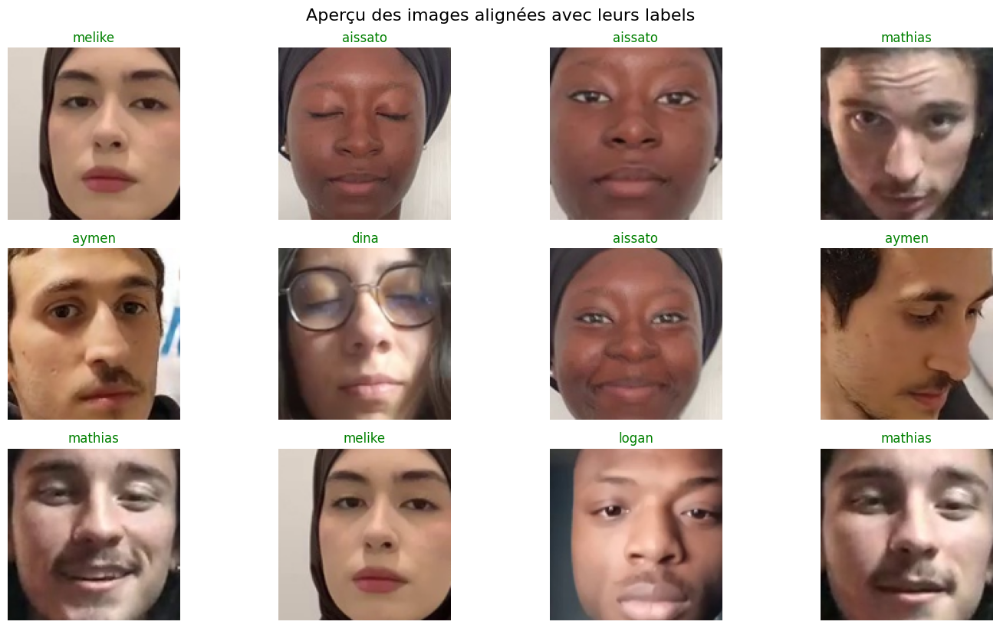

In [43]:
# Nombre d'images à afficher
n_images = 12
# Sélection aléatoire d'images

indices = np.random.choice(len(validation_faces), n_images, replace="False")

# Créer une figure
plt.figure(figsize=(15, 8))

random_faces_measures = np.array([validation_encoded_faces[idx] for idx in indices])
random_faces = np.array([validation_faces[idx] for idx in indices])

predictions = bestModel.predict(random_faces_measures)

predicted_labels = [list(set(raw_labels))[pred] for pred in predictions]

for i, idx in enumerate(indices):
    
    label = predicted_labels[i]
    img = random_faces[i]

    if predictions[i] == validation_labels[idx]:
        color = "green"
    else:
        color = "red"
        
    plt.subplot(3, 4, i + 1)
    plt.imshow(img)  # Si les images sont RGB (shape: HxWx3)
    plt.title(label, color=color)
    plt.axis('off')

plt.tight_layout()
plt.suptitle("Aperçu des images alignées avec leurs labels", fontsize=16, y=1.02)
plt.show()


partie 4

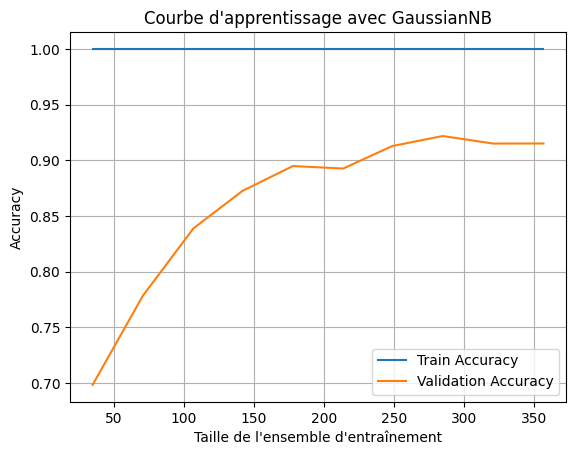

In [44]:
from sklearn.model_selection import learning_curve

train_sizes, train_scores, test_scores = learning_curve(
    bestModel, encoded_faces, intLabels, cv=5, scoring='accuracy',
    train_sizes=np.linspace(0.1, 1.0, 10)
)

train_mean = train_scores.mean(axis=1)
test_mean = test_scores.mean(axis=1)

plt.plot(train_sizes, train_mean, label='Train Accuracy')
plt.plot(train_sizes, test_mean, label='Validation Accuracy')
plt.xlabel("Taille de l'ensemble d'entraînement")
plt.ylabel("Accuracy")
plt.title("Courbe d'apprentissage avec GaussianNB")
plt.legend()
plt.grid(True)
plt.show()

---
## Credits

This assignment is based on Adam Geitgey's [post](https://medium.com/@ageitgey/machine-learning-is-fun-part-4-modern-face-recognition-with-deep-learning-c3cffc121d78).

---